In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import scipy.stats as stats
import numpy as np
from matplotlib.ticker import MaxNLocator

# 读取Excel数据时使用中文 sheet 名，但在图例中显示英文
sheets_zh = ['动物', '字母', '马里奥']  # 中文 sheet 名称
sheets_en = ['Animal', 'Letter', 'Mario']  # 英文名称，用于图例
colors = ['#984ea3', '#4daf4a', '#e41a1c']  # 调整为符合Nature标准的配色
markers = ['o', 's', 'd']  # 三组不同的marker

# 读取Excel文件
file_path = '认知训练组_filled.xlsx'

# 创建图表
plt.style.use('default')
fig, ax = plt.subplots(figsize=(7.5, 5.5), dpi=1200)

for sheet_zh, sheet_en, color, marker in zip(sheets_zh, sheets_en, colors, markers):
    df = pd.read_excel(file_path, sheet_name=sheet_zh)

    # 确保"次数"列是数值型
    df['次数'] = pd.to_numeric(df['次数'], errors='coerce')  # 将"次数"列转换为数值类型
    df = df.dropna(subset=['次数'])  # 删除无法转换为数值的行

    # 选择Block列
    blocks = ['Block1刺激难度', 'Block2刺激难度', 'Block3刺激难度', 'Block4刺激难度', 'Block5刺激难度', 'Block6刺激难度']

    # 计算每个训练天数上所有Block的均值
    mean_df = df.groupby('次数')[blocks].mean().mean(axis=1)

    # 计算标准误差 (Standard Error, SE) 使用样本数量调整
    se_df = df.groupby('次数')[blocks].sem().mean(axis=1)
    sample_size = df.groupby('次数').size()  # 获取每个训练天数的样本数量
    adjusted_se_df = se_df / np.sqrt(sample_size)  # 用样本数量调整SE

    # 计算 95% 置信区间（CI = mean ± t * SE）
    confidence = 0.95
    n = len(blocks)  # 样本数量
    t_value = stats.t.ppf((1 + confidence) / 2, n - 1)  # t 分布的临界值
    ci_df = t_value * adjusted_se_df  # 使用调整后的SE计算置信区间

    # 绘制均值和置信区间的折线图，使用不同颜色区分，并增加透明度和标记大小
    ax.errorbar(mean_df.index, mean_df, yerr=ci_df, label=f'{sheet_en} (95% CI)', linewidth=3,
                fmt=f'-{marker}', color=color, ecolor=color, elinewidth=3, capsize=5, markerfacecolor='white', alpha=0.85)
    
    # 为每个被试绘制一条透明度较低的线条
    for subject_id, subject_data in df.groupby('被试编号'):
        subject_mean = subject_data.groupby('次数')[blocks].mean().mean(axis=1)
        ax.plot(subject_mean.index, subject_mean, linestyle='-.',linewidth=0.5, color=color, alpha=0.4)

# 增加网格
ax.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.7)

# 标题、标签和刻度的优化
ax.set_title('Working memry training group (N =32)', fontsize=16, fontweight='bold', pad=15)
ax.set_xlabel('Training Days', fontsize=14, labelpad=15)
ax.set_ylabel('Mean Difficulty', fontsize=14, labelpad=15)
ax.tick_params(axis='both', which='major', labelsize=12)

# 确保X轴从0到20，步长为5
ax.set_xlim([0, 20])
ax.set_xticks(np.arange(0, 21, 2))

# 设置Y轴范围和步长
ax.set_ylim([0, 2300])
ax.set_yticks(np.arange(0, 2400, 200))

# 优化图例，位置调整到图表内
ax.legend(fontsize=11, loc='best', frameon=False,ncol=4, bbox_to_anchor=(1, -0.2))

# 移除图框的顶部和右侧线条，以符合简洁风格
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# 显示图表
plt.tight_layout()  # 优化布局
plt.savefig('./image/认知训练组.jpg', dpi=1200, bbox_inches='tight')  # 保存图片
plt.show()

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import scipy.stats as stats
import numpy as np
from matplotlib.ticker import MaxNLocator
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.stats.anova import AnovaRM

# -------------------------------
# 绘图部分
# -------------------------------
# 读取Excel数据时使用中文 sheet 名，但图例中显示英文
sheets_zh = ['动物', '字母', '马里奥']  # 中文 sheet 名称
sheets_en = ['Animal', 'Letter', 'Mario']  # 英文名称，用于图例
colors = ['#984ea3', '#4daf4a', '#e41a1c']  # Nature标准配色
markers = ['o', 's', 'd']  # 不同marker

# Excel文件路径
file_path = '认知训练组_filled.xlsx'

# -------------------------------
# 统计分析部分
# -------------------------------
# 对每个任务（sheet）分别进行重复测量方差分析及多项式趋势分析
for sheet_zh, sheet_en in zip(sheets_zh, sheets_en):
    df = pd.read_excel(file_path, sheet_name=sheet_zh)
    df['次数'] = pd.to_numeric(df['次数'], errors='coerce')
    df = df.dropna(subset=['次数'])
    
    # 选择刺激难度的Block列
    blocks = ['Block1刺激难度', 'Block2刺激难度', 'Block3刺激难度', 
              'Block4刺激难度', 'Block5刺激难度', 'Block6刺激难度']
    
    # 计算每个被试、每个训练天数的平均刺激难度
    subject_avg = df.groupby(['被试编号', '次数'])[blocks].mean().mean(axis=1).reset_index(name='difficulty')
    
    # -------------------------------
    # 重复测量方差分析（RM ANOVA）
    # -------------------------------
    try:
        aovrm = AnovaRM(subject_avg, depvar='difficulty', subject='被试编号', within=['次数'])
        res = aovrm.fit()
        print(f"\n【{sheet_en}任务】重复测量方差分析结果：")
        print(res)
    except Exception as e:
        print(f"Error in ANOVA for {sheet_en}: {e}")
    
    # -------------------------------
    # 多项式趋势分析
    # 构建线性、二次和三次趋势项（这里示例使用组均值数据）
    # -------------------------------
    group_mean = subject_avg.groupby('次数')['difficulty'].mean().reset_index()
    group_mean['session'] = group_mean['次数']
    group_mean['session2'] = group_mean['session']**2
    group_mean['session3'] = group_mean['session']**3
    
    model = smf.ols("difficulty ~ session + session2 + session3", data=group_mean).fit()
    print(f"\n【{sheet_en}任务】多项式趋势分析结果（基于组均值数据）：")
    print(model.summary())
    
    # 输出起始与结束训练天数的均值对比（示例数值可对照文中描述）
    start_day = subject_avg[subject_avg['次数'] == subject_avg['次数'].min()]['difficulty'].mean()
    end_day = subject_avg[subject_avg['次数'] == subject_avg['次数'].max()]['difficulty'].mean()
    print(f"\n【{sheet_en}任务】训练起始日平均难度：{start_day:.2f} ms, 训练结束日平均难度：{end_day:.2f} ms")


【Animal任务】重复测量方差分析结果：
              Anova
   F Value  Num DF  Den DF  Pr > F
----------------------------------
次数 35.8058 19.0000 589.0000 0.0000


【Animal任务】多项式趋势分析结果（基于组均值数据）：
                            OLS Regression Results                            
Dep. Variable:             difficulty   R-squared:                       0.981
Model:                            OLS   Adj. R-squared:                  0.978
Method:                 Least Squares   F-statistic:                     281.7
Date:                Mon, 10 Mar 2025   Prob (F-statistic):           4.71e-14
Time:                        08:23:38   Log-Likelihood:                -108.59
No. Observations:                  20   AIC:                             225.2
Df Residuals:                      16   BIC:                             229.2
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std e

In [2]:
import pandas as pd

file_path = '认知训练组.xlsx'
output_file = '认知训练组_filled.xlsx'
sheets = ['动物', '字母', '马里奥']

# 定义完整的训练天数范围：1~20
all_days = list(range(1, 21))

# 定义函数，对单个被试的数据进行补全（先聚合再填充）
def fill_missing(subject_df):
    # 对重复的“次数”数据进行聚合（例如取均值）
    subject_df = subject_df.groupby('次数', as_index=False).mean()
    # 按“次数”排序，并将“次数”列设置为索引
    subject_df = subject_df.sort_values('次数').set_index('次数')
    # 重新索引，补全缺失的训练天数
    subject_df = subject_df.reindex(all_days)
    # 使用前向填充，再使用后向填充补全缺失值
    subject_df = subject_df.fillna(method='ffill').fillna(method='bfill')
    # 恢复“次数”列
    subject_df = subject_df.reset_index()
    # 对于“被试编号”列，若有缺失，用前向和后向填充补全
    subject_df['被试编号'] = subject_df['被试编号'].fillna(method='ffill').fillna(method='bfill')
    return subject_df

# 用来存储每个 sheet 处理后的 DataFrame
all_filled_dfs = {}

for sheet in sheets:
    print(f"\n【{sheet}】")
    df = pd.read_excel(file_path, sheet_name=sheet)
    
    # 将所有列全部转换为数值型（无法转换的将变为 NaN）
    df = df.apply(pd.to_numeric, errors='coerce')
    
    # 删除“次数”列中无法转换为数值的行
    df = df.dropna(subset=['次数'])
    
    # 对每个被试的数据进行补全：不足20天的数据通过附近的行填充（先聚合重复数据）
    df_filled = df.groupby('被试编号').apply(fill_missing).reset_index(drop=True)
    
    # 统计每个训练天数的样本数量
    counts = df_filled.groupby('次数').size()
    print("每个训练天数的样本数量：")
    print(counts)
    
    # 检查每个被试参与的训练天数数量
    subject_counts = df_filled.groupby('被试编号')['次数'].nunique()
    print("\n每个被试参与的训练天数数量：")
    print(subject_counts)
    
    # 将处理后的数据存入字典，以便后续保存
    all_filled_dfs[sheet] = df_filled

# 将所有处理后的数据保存到新的 Excel 文件中，每个 sheet 分别保存对应的数据
with pd.ExcelWriter(output_file) as writer:
    for sheet, df_filled in all_filled_dfs.items():
        df_filled.to_excel(writer, sheet_name=sheet, index=False)

print(f"\n数据已保存至 {output_file}")


【动物】
每个训练天数的样本数量：
次数
1     32
2     32
3     32
4     32
5     32
6     32
7     32
8     32
9     32
10    32
11    32
12    32
13    32
14    32
15    32
16    32
17    32
18    32
19    32
20    32
dtype: int64

每个被试参与的训练天数数量：
被试编号
14.0     20
19.0     20
20.0     20
21.0     20
33.0     20
35.0     20
36.0     20
38.0     20
50.0     20
51.0     20
155.0    20
160.0    20
161.0    20
162.0    20
169.0    20
172.0    20
175.0    20
184.0    20
185.0    20
194.0    20
195.0    20
300.0    20
301.0    20
302.0    20
303.0    20
304.0    20
305.0    20
501.0    20
505.0    20
511.0    20
512.0    20
513.0    20
Name: 次数, dtype: int64

【字母】
每个训练天数的样本数量：
次数
1     32
2     32
3     32
4     32
5     32
6     32
7     32
8     32
9     32
10    32
11    32
12    32
13    32
14    32
15    32
16    32
17    32
18    32
19    32
20    32
dtype: int64

每个被试参与的训练天数数量：
被试编号
14.0     20
19.0     20
20.0     20
21.0     20
33.0     20
35.0     20
36.0     20
38.0     20
50.0     20
51.0     20
1

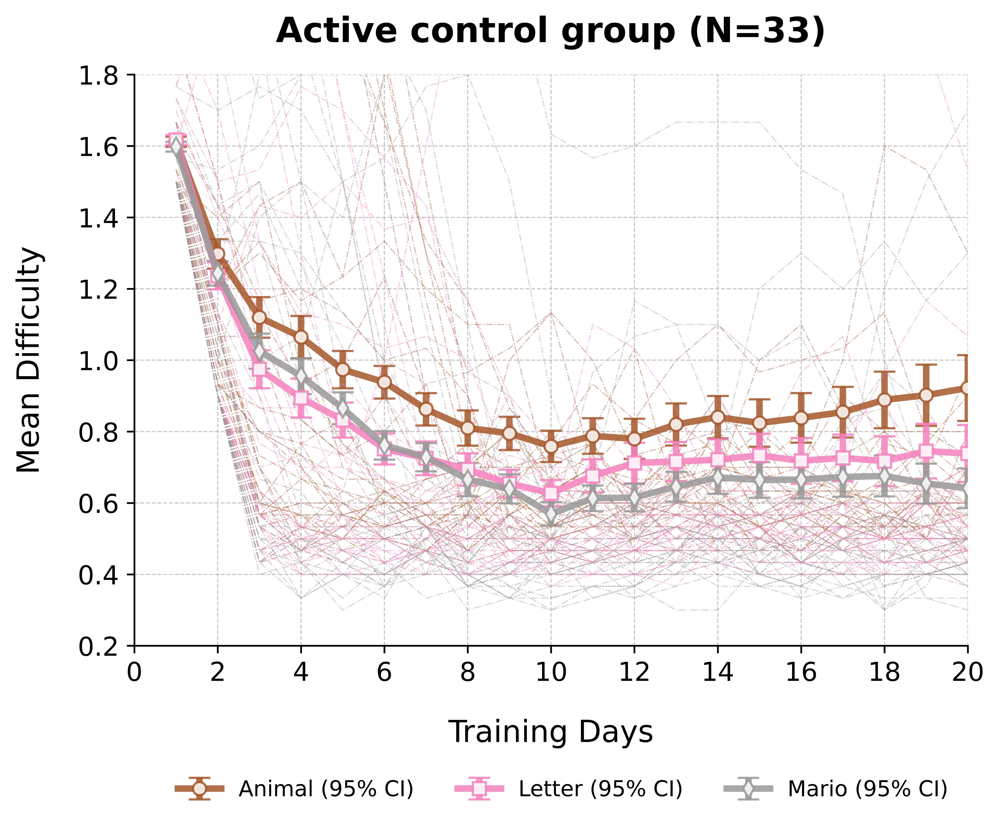

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import scipy.stats as stats
import numpy as np
from matplotlib.ticker import MaxNLocator

# 读取Excel数据时使用中文 sheet 名，但在图例中显示英文
sheets_zh = ['动物', '字母', '马里奥']  # 中文 sheet 名称
sheets_en = ['Animal', 'Letter', 'Mario']  # 英文名称，用于图例
colors = ['#a65628', '#f781bf', '#999999']
markers = ['o', 's', 'd']  # 三组不同的marker

# 读取Excel文件
file_path = '简单反应训练.xlsx'

# 创建图表
plt.style.use('default')
fig, ax = plt.subplots(figsize=(6.5, 5.5), dpi=1200)

for sheet_zh, sheet_en, color, marker in zip(sheets_zh, sheets_en, colors, markers):
    df = pd.read_excel(file_path, sheet_name=sheet_zh)

    # 确保"次数"列是数值型
    df['次数'] = pd.to_numeric(df['次数'], errors='coerce')  # 将"次数"列转换为数值类型
    df = df.dropna(subset=['次数'])  # 删除无法转换为数值的行

    # 选择Block列
    blocks = ['Block1刺激难度', 'Block2刺激难度', 'Block3刺激难度', 'Block4刺激难度', 'Block5刺激难度', 'Block6刺激难度']

    # 计算每个训练天数上所有Block的均值
    mean_df = df.groupby('次数')[blocks].mean().mean(axis=1)

    # 计算标准误差 (Standard Error, SE) 使用样本数量调整
    se_df = df.groupby('次数')[blocks].sem().mean(axis=1)
    sample_size = df.groupby('次数').size()  # 获取每个训练天数的样本数量
    adjusted_se_df = se_df / np.sqrt(sample_size)  # 用样本数量调整SE

    # 计算 95% 置信区间（CI = mean ± t * SE）
    confidence = 0.95
    n = len(blocks)  # 样本数量
    t_value = stats.t.ppf((1 + confidence) / 2, n - 1)  # t 分布的临界值
    ci_df = t_value * adjusted_se_df  # 使用调整后的SE计算置信区间

    # 绘制均值和置信区间的折线图，使用不同颜色区分，并增加透明度和标记大小
    ax.errorbar(mean_df.index, mean_df, yerr=ci_df, label=f'{sheet_en} (95% CI)', linewidth=3,
                fmt=f'-{marker}', color=color, ecolor=color, elinewidth=3, capsize=5, markerfacecolor='white', alpha=0.85)
    
    # 为每个被试绘制一条透明度较低的线条
    for subject_id, subject_data in df.groupby('被试编号'):
        subject_mean = subject_data.groupby('次数')[blocks].mean().mean(axis=1)
        ax.plot(subject_mean.index, subject_mean,  linestyle='-.',linewidth=0.5, color=color, alpha=0.4)

# 增加网格
ax.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.7)

# 标题、标签和刻度的优化
ax.set_title('Active control group (N=33)', fontsize=16, fontweight='bold', pad=15)
ax.set_xlabel('Training Days', fontsize=14, labelpad=15)
ax.set_ylabel('Mean Difficulty', fontsize=14, labelpad=15)
ax.tick_params(axis='both', which='major', labelsize=12)

# 确保X轴从0到20，步长为5
ax.set_xlim([0, 20])
ax.set_xticks(np.arange(0, 21, 2))

# 设置Y轴范围和步长
ax.set_ylim([0.2, 1.8])
ax.set_yticks(np.arange(0.2, 1.9, 0.2))

# 优化图例，位置调整到图表内
ax.legend(fontsize=10, loc='best', frameon=False,ncol=3, bbox_to_anchor=(1, -0.2))

# 移除图框的顶部和右侧线条，以符合简洁风格
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()  # 优化布局
plt.savefig('./image/简单组.jpg', dpi=1200, bbox_inches='tight')  # 保存图片
plt.show()

In [4]:
import pandas as pd

file_path = '简单反应训练.xlsx'
sheets = ['动物', '字母', '马里奥']

for sheet in sheets:
    print(f"\n【{sheet}】")
    df = pd.read_excel(file_path, sheet_name=sheet)
    
    # 将所有列全部转换为数值型（无法转换的将变为NaN）
    df = df.apply(pd.to_numeric, errors='coerce')
    
    # 删除“次数”列中无法转换为数值的行
    df = df.dropna(subset=['次数'])
    
    # 统计每个训练天数的样本数量
    counts = df.groupby('次数').size()
    print("每个训练天数的样本数量：")
    print(counts)
    
    # 检查每个被试参与的训练天数，看看是否有数据缺失
    subject_counts = df.groupby('被试编号')['次数'].nunique()
    print("\n每个被试参与的训练天数数量：")
    print(subject_counts)


【动物】
每个训练天数的样本数量：
次数
1     33
2     33
3     33
4     33
5     33
6     33
7     33
8     33
9     33
10    33
11    33
12    33
13    33
14    33
15    33
16    33
17    33
18    33
19    33
20    33
dtype: int64

每个被试参与的训练天数数量：
Series([], Name: 次数, dtype: int64)

【字母】
每个训练天数的样本数量：
次数
1     33
2     33
3     33
4     33
5     33
6     33
7     33
8     33
9     33
10    33
11    33
12    33
13    33
14    33
15    33
16    33
17    33
18    33
19    33
20    33
dtype: int64

每个被试参与的训练天数数量：
Series([], Name: 次数, dtype: int64)

【马里奥】
每个训练天数的样本数量：
次数
1     33
2     33
3     33
4     33
5     33
6     33
7     33
8     33
9     33
10    33
11    33
12    33
13    33
14    33
15    33
16    33
17    33
18    33
19    33
20    33
dtype: int64

每个被试参与的训练天数数量：
Series([], Name: 次数, dtype: int64)


In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import scipy.stats as stats
import numpy as np
from matplotlib.ticker import MaxNLocator
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.stats.anova import AnovaRM

# -------------------------------
# 绘图部分
# -------------------------------
# 读取Excel数据时使用中文 sheet 名，但图例中显示英文
sheets_zh = ['动物', '字母', '马里奥']  # 中文 sheet 名称
sheets_en = ['Animal', 'Letter', 'Mario']  # 英文名称，用于图例
colors = ['#984ea3', '#4daf4a', '#e41a1c']  # Nature标准配色
markers = ['o', 's', 'd']  # 不同marker

# Excel文件路径
file_path = '简单反应训练.xlsx'

# -------------------------------
# 统计分析部分
# -------------------------------
# 对每个任务（sheet）分别进行重复测量方差分析及多项式趋势分析
for sheet_zh, sheet_en in zip(sheets_zh, sheets_en):
    df = pd.read_excel(file_path, sheet_name=sheet_zh)
    df['次数'] = pd.to_numeric(df['次数'], errors='coerce')
    df = df.dropna(subset=['次数'])
    
    # 选择刺激难度的Block列
    blocks = ['Block1刺激难度', 'Block2刺激难度', 'Block3刺激难度', 
              'Block4刺激难度', 'Block5刺激难度', 'Block6刺激难度']
    
    # 计算每个被试、每个训练天数的平均刺激难度
    subject_avg = df.groupby(['被试编号', '次数'])[blocks].mean().mean(axis=1).reset_index(name='difficulty')
    
    # -------------------------------
    # 重复测量方差分析（RM ANOVA）
    # -------------------------------
    try:
        aovrm = AnovaRM(subject_avg, depvar='difficulty', subject='被试编号', within=['次数'])
        res = aovrm.fit()
        print(f"\n【{sheet_en}任务】重复测量方差分析结果：")
        print(res)
    except Exception as e:
        print(f"Error in ANOVA for {sheet_en}: {e}")
    
    # -------------------------------
    # 多项式趋势分析
    # 构建线性、二次和三次趋势项（这里示例使用组均值数据）
    # -------------------------------
    group_mean = subject_avg.groupby('次数')['difficulty'].mean().reset_index()
    group_mean['session'] = group_mean['次数']
    group_mean['session2'] = group_mean['session']**2
    group_mean['session3'] = group_mean['session']**3
    
    model = smf.ols("difficulty ~ session + session2 + session3", data=group_mean).fit()
    print(f"\n【{sheet_en}任务】多项式趋势分析结果（基于组均值数据）：")
    print(model.summary())
    
    # 输出起始与结束训练天数的均值对比（示例数值可对照文中描述）
    start_day = subject_avg[subject_avg['次数'] == subject_avg['次数'].min()]['difficulty'].mean()
    end_day = subject_avg[subject_avg['次数'] == subject_avg['次数'].max()]['difficulty'].mean()
    print(f"\n【{sheet_en}任务】训练起始日平均难度：{start_day:.2f} ms, 训练结束日平均难度：{end_day:.2f} ms")


【Animal任务】重复测量方差分析结果：
              Anova
   F Value  Num DF  Den DF  Pr > F
----------------------------------
次数  7.3746 19.0000 605.0000 0.0000


【Animal任务】多项式趋势分析结果（基于组均值数据）：
                            OLS Regression Results                            
Dep. Variable:             difficulty   R-squared:                       0.974
Model:                            OLS   Adj. R-squared:                  0.969
Method:                 Least Squares   F-statistic:                     197.4
Date:                Mon, 10 Mar 2025   Prob (F-statistic):           7.56e-13
Time:                        08:23:43   Log-Likelihood:                 40.020
No. Observations:                  20   AIC:                            -72.04
Df Residuals:                      16   BIC:                            -68.06
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std e